# Pegasus-Montage DAG to RADICAL PST

## Setup on BlueSky

Path to software:
- Pegasus 5.0: `/files0/oddite/leeh736/pegasus-5.0.2`
- Montage 6.0: `/files0/oddite/leeh736/Montage`    
- Workflow Example: `/files0/oddite/leeh736/montage-workflow-v3`

Envs to activate:
- Module required to load: `module load java/11.0.14.1_1`
- Path to enable: `export PATH=$PATH:/files0/oddite/leeh736/Montage/bin/:/files0/oddite/leeh736/pegasus-5.0.2/bin/`

## Loading Pegasus YAML

The base example is from https://github.com/pegasus-isi/montage-workflow-v3/blob/master/example-dss.sh
which provides a workflow description in a YAML file, such as what to run and how to get.
The basic settings create a 2x2 degree mosaic centered on 56.7 24.0, with single band for the final JPEG output. A 1 degree is applied which will reduce a number of tasks to process relatively small number of input images and thus the workflow finishes quickly with a small number of tasks.

Once `example-dss.sh` is finished, there is a `data` sub-directory created which contains `montage-workflow.yml`.


In [6]:
import yaml

f = open("montage-workflow.yml")
data = yaml.load(f,Loader=yaml.FullLoader)

Note that the yaml is produced by `montage-workflow.py` where the Python APIs are called (astropy, pegasuspy)

## Data Structure of Pegasus Workflow

There are seven keys from the YAML file, which contain pegasus information and workflow.

Workflow descriptions i.e., tasks and input/outputs are recorded in the following sections:
- `replicaCatalog`: a list of input files containing a path to locate
- `transformationCatalog`: a list of executables containing a resource requirement e.g., 1GB memory
- `jobs`: a list of tasks along with arguments to run, `replicaCatalog` and `transformationCatalog` are referenced
- `jobDependencies`: a list of pairs about parent/children tasks, JOB IDs are referenced to look up details in `jobs`

In [8]:
data.keys()

dict_keys(['x-pegasus', 'pegasus', 'name', 'replicaCatalog', 'transformationCatalog', 'jobs', 'jobDependencies'])

### Input Files (`replicaCatalog`)

In [13]:
files = data['replicaCatalog']['replicas']
fcnt = len(files)
file_0 = files[0]

In [26]:
from pprint import pprint
print (f"{fcnt} files found, and file[0] is: ")
pprint(file_0, indent=4)

23 files found, and file[0] is: 
{   'lfn': 'region.hdr',
    'pfns': [   {   'pfn': 'file:///files0/oddite/leeh736/montage-workflow-v3/data/region.hdr',
                    'site': 'local'}]}


### Binaries (`transformationCatalog`)

In [18]:
bins = data['transformationCatalog']['transformations']
bcnt = len(bins)
bin_0 = bins[0]

In [27]:
print (f"{bcnt} binaries found, and bin[0] is: ")
pprint(bin_0, indent=4)

73 binaries found, and bin[0] is: 
{   'name': 'mConvert',
    'profiles': {   'condor': {'request_memory': '1 GB'},
                    'env': {'PATH': '/usr/bin:/bin:.'}},
    'sites': [   {   'name': 'local',
                     'pfn': '/files0/oddite/leeh736/Montage/bin/mConvert',
                     'type': 'stageable'}]}


### Jobs (`jobs`)

In [20]:
jobs = data['jobs']
jcnt = len(jobs)
job_0 = jobs[0]

In [28]:
print (f"{jcnt} jobs (tasks) found, and job[0] is: ")
pprint(job_0, indent=4)

157 jobs (tasks) found, and job[0] is: 
{   'arguments': [   '-X',
                     'poss2ukstu_blue_001_001.fits',
                     'pposs2ukstu_blue_001_001.fits',
                     'region-oversized.hdr'],
    'id': 'ID0000001',
    'name': 'mProject',
    'type': 'job',
    'uses': [   {   'lfn': 'pposs2ukstu_blue_001_001_area.fits',
                    'registerReplica': True,
                    'stageOut': False,
                    'type': 'output'},
                {   'lfn': 'pposs2ukstu_blue_001_001.fits',
                    'registerReplica': True,
                    'stageOut': False,
                    'type': 'output'},
                {'lfn': 'region-oversized.hdr', 'type': 'input'},
                {'lfn': 'poss2ukstu_blue_001_001.fits', 'type': 'input'}]}


### Job Dependencies (`jobDependencies`)

In [29]:
jds = data['jobDependencies']
jdcnt = len(jds)
jd_0 = jds[0]

In [34]:
print (f"{jdcnt} job dependencies found, and jd[0] is: ")
pprint(jd_0, indent=4)
pprint(jobs[0], indent=4)

156 job dependencies found, and jd[0] is: 
{   'children': [   'ID0000139',
                    'ID0000018',
                    'ID0000019',
                    'ID0000020',
                    'ID0000024',
                    'ID0000030',
                    'ID0000031',
                    'ID0000021',
                    'ID0000017',
                    'ID0000023',
                    'ID0000027',
                    'ID0000025',
                    'ID0000029',
                    'ID0000026',
                    'ID0000022',
                    'ID0000028'],
    'id': 'ID0000001'}
{   'arguments': [   '-X',
                     'poss2ukstu_blue_001_001.fits',
                     'pposs2ukstu_blue_001_001.fits',
                     'region-oversized.hdr'],
    'id': 'ID0000001',
    'name': 'mProject',
    'type': 'job',
    'uses': [   {   'lfn': 'pposs2ukstu_blue_001_001_area.fits',
                    'registerReplica': True,
                    'stageOut': False,
          

## Extracting DAG from YAML

We use `graphviz` tool, for example:
- `pegasus-graphviz --output job_dependency.dot data/montage-workflow.yml`

In [39]:
import pydot

(graph_jd,) = pydot.graph_from_dot_file('job_dependency.dot')
graph_jd.write_png('montage-job-dep.png')

### Job Dependency in DAG

First dag to visualize is about job dependency only. File names and task names are omitted.

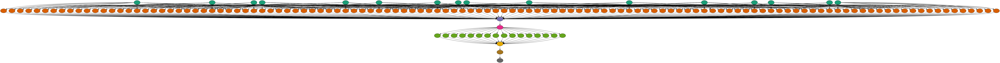

In [40]:
from IPython.display import Image
Image('montage-job-dep.png')

### Pegasus Work DAG

Details of actual workflow runs are also provided in DAG because Pegasus-plan prepares task executions, which can be found, e.g.: `work/$USERID/pegasus/montage/run0001/montage-0.dag`

In [46]:
(graph_work,) = pydot.graph_from_dot_file('montage-0.dot')
graph_work.write_png('montage-work.png')

In [47]:
Image('montage-work.png')

## Converting DAG to RADICAL PST

Pipeline/Stage/Task structure of RADICAL-EnTK can be simplified in the following format:


- Pipeline: `Python Set`
- Stage: `Python List`
- Task: `Python Collection, unordered list`

And the combined structure looks like: `set(List[set(task1,task2,task3), set(task4,task5,taskx), ...], List[…])`


In [66]:
g = pydot.Dot(graph_type = 'digraph', rankdir = 'LR')

n1 = pydot.Node('1')
n2 = pydot.Node('2')
n3 = pydot.Node('3')
n4 = pydot.Node('4')
n5 = pydot.Node('5')

e12 = pydot.Edge(n1, n2)
e23 = pydot.Edge(n2, n3)
e14 = pydot.Edge(n1, n4)
e34 = pydot.Edge(n3, n4)
e45 = pydot.Edge(n4, n5)


g.add_node(n1)
g.add_node(n2)
g.add_node(n3)
g.add_node(n4)
g.add_node(n5)
g.add_edge(e12)
g.add_edge(e23)
g.add_edge(e14)
g.add_edge(e34)
g.add_edge(e45)


In [67]:
g.write_png('test.png')

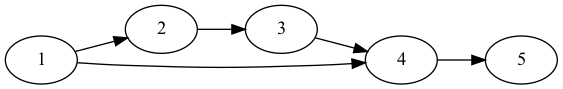

In [68]:
Image('test.png')

## Conversion to RADICAL PST; counting maximum edges

In [49]:
dict_dep = {}

for i in jds:
    dict_dep[i['id']] = i['children']

ordered = {}
for pjob_id, child_ids in dict_dep.items():
    if pjob_id not in ordered:
       ordered[pjob_id] = 1
    for cjob_id in child_ids:
        if cjob_id not in ordered:
           ordered[cjob_id] = ordered[pjob_id] + 1
        else:
           ordered[cjob_id] = max(ordered[pjob_id] + 1, ordered[cjob_id])

pprint(ordered, indent=4)

{   'ID0000001': 1,
    'ID0000002': 1,
    'ID0000003': 1,
    'ID0000004': 1,
    'ID0000005': 1,
    'ID0000006': 1,
    'ID0000007': 1,
    'ID0000008': 1,
    'ID0000009': 1,
    'ID0000010': 1,
    'ID0000011': 1,
    'ID0000012': 1,
    'ID0000013': 1,
    'ID0000014': 1,
    'ID0000015': 1,
    'ID0000016': 1,
    'ID0000017': 2,
    'ID0000018': 2,
    'ID0000019': 2,
    'ID0000020': 2,
    'ID0000021': 2,
    'ID0000022': 2,
    'ID0000023': 2,
    'ID0000024': 2,
    'ID0000025': 2,
    'ID0000026': 2,
    'ID0000027': 2,
    'ID0000028': 2,
    'ID0000029': 2,
    'ID0000030': 2,
    'ID0000031': 2,
    'ID0000032': 2,
    'ID0000033': 2,
    'ID0000034': 2,
    'ID0000035': 2,
    'ID0000036': 2,
    'ID0000037': 2,
    'ID0000038': 2,
    'ID0000039': 2,
    'ID0000040': 2,
    'ID0000041': 2,
    'ID0000042': 2,
    'ID0000043': 2,
    'ID0000044': 2,
    'ID0000045': 2,
    'ID0000046': 2,
    'ID0000047': 2,
    'ID0000048': 2,
    'ID0000049': 2,
    'ID0000050': 2,
